In [1]:
from bs4 import BeautifulSoup

## Queries

In [2]:
import os

os.system("pip install python-dotenv")

0

In [3]:
import sys
sys.path.append(os.path.abspath('../'))
from dotenv import load_dotenv
load_dotenv()

True

In [4]:
file_queries = os.getenv('REPORT_SERVICE')+"database/report/2311"
print(file_queries)

http://10.10.10.50:8000/report-service/api/v1/database/report/2311


In [5]:
from urllib.request import urlopen

# Open the file using urlopen
with urlopen(file_queries) as file:
    # Read the HTML content from the file
    html_content = file.read().decode('utf-8')

# Parse the HTML using BeautifulSoup
queries_ = BeautifulSoup(html_content, 'html.parser')

# Print the prettified HTML
print(queries_.prettify())

<!DOCTYPE html>
<html lang="en">
 <head>
  <title>
   pgBadger :: PostgreSQL Log Analyzer
  </title>
  <meta content="text/html; charset=utf-8" http-equiv="Content-Type"/>
  <meta content="noindex,nofollow" name="robots"/>
  <meta content="Fri Nov 17 11:24:41 2023" http-equiv="Expires"/>
  <meta content="pgBadger v9.2" http-equiv="Generator"/>
  <meta content="Fri Nov 17 11:24:41 2023" http-equiv="Date"/>
  <link href="data:image/x-icon;base64,
AAABAAEAIyMQAAEABAA8BAAAFgAAACgAAAAjAAAARgAAAAEABAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAgAAGRsZACgqKQA2OTcASEpJAFpdWwBoa2kAeHt5AImMigCeoZ8AsLOxAMTHxQDR1NIA
5enmAPv+/AAAAAAA///////////////////////wAAD///////////H///////////AAAP//////
//9Fq7Yv////////8AAA////////8V7u7qD////////wAAD///////8B7qWN5AL///////AAAP//
///y8Avrc3rtMCH/////8AAA/////xABvbAAAJ6kAA/////wAAD////wAG5tQAAADp6RAP////AA
AP//MQBd7C2lRESOWe5xAD//8AAA//8APO7iC+7e7u4A3uxwBf/wAAD/9Aju7iAAvu7u0QAN7ukA
7/AAAP/wCe7kAAAF7ugAAAHO6xD/8AAA//AK7CAAAAHO1AAAABnrEP/wAAD/8ArAAAAAAc7kAAAA
AIwQ//AAAP/w

In [6]:
tabbable = queries_.find('div', {'class': 'tabbable'})
tabbable

<div class="tabbable">
<ul class="nav nav-tabs">
<li class="active"><a data-toggle="tab" href="#tab-queries"><i class="glyphicon icon-question-sign"></i> Queries</a></li>
<li><a data-toggle="tab" href="#tab-events"><i class="glyphicon icon-bullhorn"></i> Events</a></li>
<li><a data-toggle="tab" href="#tab-vacuums"><i class="glyphicon icon-cogs"></i> Vacuums</a></li>
<li><a data-toggle="tab" href="#tab-tempfiles"><i class="glyphicon icon-file"></i> Temporary files</a></li>
<li><a data-toggle="tab" href="#tab-sessions"><i class="glyphicon icon-off"></i> Sessions</a></li>
<li><a data-toggle="tab" href="#tab-connections"><i class="glyphicon icon-external-link-sign"></i> Connections</a></li>
</ul>
<div class="tab-content">
<div class="tab-pane active" id="tab-queries">
<ul>
<li class="first"><span class="figure">66</span> <span class="figure-label">Number of unique normalized queries</span></li>
<li><span class="figure">2,451,152</span> <span class="figure-label">Number of queries</span></l

In [7]:
tab_content1 = tabbable.find('div', {'class': 'tab-content'})
tab_content1

<div class="tab-content">
<div class="tab-pane active" id="tab-queries">
<ul>
<li class="first"><span class="figure">66</span> <span class="figure-label">Number of unique normalized queries</span></li>
<li><span class="figure">2,451,152</span> <span class="figure-label">Number of queries</span></li>
<li><span class="figure">0ms</span> <span class="figure-label">Total query duration</span></li>
<li><span class="figure">2023-10-31 10:38:47</span> <span class="figure-label">First query</span></li>
<li><span class="figure">2023-11-17 04:15:46</span> <span class="figure-label">Last query</span></li>
<li><span class="figure">368 queries/s at 2023-11-10 19:00:01</span> <span class="figure-label">Query peak</span></li>
</ul>
</div>
<div class="tab-pane" id="tab-events">
<ul>
<li class="first"><span class="figure">78</span> <span class="figure-label">Number of events</span></li>
<li><span class="figure">4</span> <span class="figure-label">Number of unique normalized events</span></li>
<li><span

In [8]:
element = tab_content1.find('div', {'class': 'tab-pane active', 'id': 'tab-queries'})

# type(element)
element = '"""'+ str(element) + '"""'
element

'"""<div class="tab-pane active" id="tab-queries">\n<ul>\n<li class="first"><span class="figure">66</span> <span class="figure-label">Number of unique normalized queries</span></li>\n<li><span class="figure">2,451,152</span> <span class="figure-label">Number of queries</span></li>\n<li><span class="figure">0ms</span> <span class="figure-label">Total query duration</span></li>\n<li><span class="figure">2023-10-31 10:38:47</span> <span class="figure-label">First query</span></li>\n<li><span class="figure">2023-11-17 04:15:46</span> <span class="figure-label">Last query</span></li>\n<li><span class="figure">368 queries/s at 2023-11-10 19:00:01</span> <span class="figure-label">Query peak</span></li>\n</ul>\n</div>"""'

In [9]:
# Parse the HTML content
soup = BeautifulSoup(element, 'html.parser')

# Get the text content
text_content = soup.get_text(strip=True, separator='\n')

print(text_content)

"""
66
Number of unique normalized queries
2,451,152
Number of queries
0ms
Total query duration
2023-10-31 10:38:47
First query
2023-11-17 04:15:46
Last query
368 queries/s at 2023-11-10 19:00:01
Query peak
"""


In [10]:
# Parse the HTML content
soup = BeautifulSoup(element, 'html.parser')

# Get the text content
text_content = soup.get_text(strip=True, separator='\n')

# Split the text content into a list of lines
lines = text_content.split('\n')

# Create variables to store the values
num_unique_queries = int(lines[1].replace(',', ''))
num_queries = int(lines[3].replace(',', ''))
total_query_duration = lines[5]
first_query = lines[7]
last_query = lines[9]
queries_per_second = lines[11]

# Print or use the variables as needed
print("Number of unique normalized queries:", num_unique_queries)
print("Number of queries:", num_queries)
print("Total query duration:", total_query_duration)
print("First query:", first_query)
print("Last query:", last_query)
print("Queries per second:", queries_per_second)

Number of unique normalized queries: 66
Number of queries: 2451152
Total query duration: 0ms
First query: 2023-10-31 10:38:47
Last query: 2023-11-17 04:15:46
Queries per second: 368 queries/s at 2023-11-10 19:00:01


In [11]:
import re

# Use regex to find numbers
match = re.search(r'\b\d+\b', queries_per_second)

# If a number is found in the text
if match:
    queries_per_second = int(match.group())
    print(queries_per_second)
else:
    print("Variable value not found")

368


In [12]:
# formatted_num_queries
num_queries = '{:,}'.format(num_queries)
print(num_queries)

2,451,152


## Queries by type

In [13]:
file_type = os.getenv('REPORT_SERVICE')+"database/report/2311#queries-by-type"
print(file_type)

http://10.10.10.50:8000/report-service/api/v1/database/report/2311#queries-by-type


In [14]:
# Open the file using urlopen
with urlopen(file_type) as file:
    # Read the HTML content from the file
    html = file.read().decode('utf-8')

# Parse the HTML using BeautifulSoup
type = BeautifulSoup(html, 'html.parser')

# Print the prettified HTML
print(type.prettify())

<!DOCTYPE html>
<html lang="en">
 <head>
  <title>
   pgBadger :: PostgreSQL Log Analyzer
  </title>
  <meta content="text/html; charset=utf-8" http-equiv="Content-Type"/>
  <meta content="noindex,nofollow" name="robots"/>
  <meta content="Fri Nov 17 11:24:41 2023" http-equiv="Expires"/>
  <meta content="pgBadger v9.2" http-equiv="Generator"/>
  <meta content="Fri Nov 17 11:24:41 2023" http-equiv="Date"/>
  <link href="data:image/x-icon;base64,
AAABAAEAIyMQAAEABAA8BAAAFgAAACgAAAAjAAAARgAAAAEABAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAgAAGRsZACgqKQA2OTcASEpJAFpdWwBoa2kAeHt5AImMigCeoZ8AsLOxAMTHxQDR1NIA
5enmAPv+/AAAAAAA///////////////////////wAAD///////////H///////////AAAP//////
//9Fq7Yv////////8AAA////////8V7u7qD////////wAAD///////8B7qWN5AL///////AAAP//
///y8Avrc3rtMCH/////8AAA/////xABvbAAAJ6kAA/////wAAD////wAG5tQAAADp6RAP////AA
AP//MQBd7C2lRESOWe5xAD//8AAA//8APO7iC+7e7u4A3uxwBf/wAAD/9Aju7iAAvu7u0QAN7ukA
7/AAAP/wCe7kAAAF7ugAAAHO6xD/8AAA//AK7CAAAAHO1AAAABnrEP/wAAD/8ArAAAAAAc7kAAAA
AIwQ//AAAP/w

In [15]:
# from urllib.request import urlopen

# # Specify the file path
# file_type = 'file:///D:/maholan/mwa/out.html#queries-by-type'

# # Open the file using urlopen
# with urlopen(file_type) as file:
#     # Read the HTML content from the file
#     html = file.read().decode('utf-8')

# # Parse the HTML using BeautifulSoup
# type = BeautifulSoup(html, 'html.parser')

# # Print the prettified HTML
# print(type.prettify())

In [16]:
analy = type.find('div', {'class': 'analysis-item row', 'id': 'queries-by-type'})
analy

<div class="analysis-item row" id="queries-by-type">
<h2><i class="glyphicon icon-question-sign"></i> Queries by type</h2>
<div class="col-md-3">
<h3 class="">Key values</h3>
<div class="well key-figures">
<ul>
<li><span class="figure">1,047,970</span> <span class="figure-label">Total read queries</span></li>
<li><span class="figure">1,398,030</span> <span class="figure-label">Total write queries</span></li>
</ul>
</div>
</div>
<div class="col-md-9">
<div class="tabbable">
<ul class="nav nav-tabs">
<li class="active"><a data-toggle="tab" href="#queries-by-type-graph">Chart</a></li>
<li><a data-toggle="tab" href="#queries-by-type-table">Table</a></li>
</ul>
<div class="tab-content">
<div class="tab-pane active" id="queries-by-type-graph">
<div class="jqplot-graph piegraph" id="graph_queriesbytype"></div>
<script type="text/javascript">
/* <![CDATA[ */
var data_26 = [ ['DELETE', 347779],['INSERT', 467413],['SELECT', 1047970],['Sum query types < 2%', 5152],['TCL', 464738],['UPDATE', 11810

In [17]:
tab_content2 = analy.find('div', {'class': 'tab-content'})
tab_content2

<div class="tab-content">
<div class="tab-pane active" id="queries-by-type-graph">
<div class="jqplot-graph piegraph" id="graph_queriesbytype"></div>
<script type="text/javascript">
/* <![CDATA[ */
var data_26 = [ ['DELETE', 347779],['INSERT', 467413],['SELECT', 1047970],['Sum query types < 2%', 5152],['TCL', 464738],['UPDATE', 118100] ];

create_download_button(26, 'btn btn-default');
var graph_queriesbytype = create_piechart('graph_queriesbytype', 'Type of queries', data_26);
add_download_button_event(26, 'graph_queriesbytype');
/* ]]> */
</script>
</div>
<div class="tab-pane" id="queries-by-type-table">
<table class="table table-striped table-hover">
<thead>
<tr>
<th>Type</th>
<th>Count</th>
<th>Percentage</th>
</tr>
</thead>
<tbody>
<tr><td>SELECT</td><td>1,047,970</td><td>42.75%</td></tr><tr><td>INSERT</td><td>467,413</td><td>19.07%</td></tr><tr><td>UPDATE</td><td>118,100</td><td>4.82%</td></tr><tr><td>DELETE</td><td>347,779</td><td>14.19%</td></tr><tr><td>COPY FROM</td><td>0</td>

In [18]:
element2 = tab_content2.find('script', {'type': 'text/javascript'})
element2

# type(element2)
element2 = '"""'+ str(element2) + '"""'
element2

'"""<script type="text/javascript">\n/* <![CDATA[ */\nvar data_26 = [ [\'DELETE\', 347779],[\'INSERT\', 467413],[\'SELECT\', 1047970],[\'Sum query types < 2%\', 5152],[\'TCL\', 464738],[\'UPDATE\', 118100] ];\n\ncreate_download_button(26, \'btn btn-default\');\nvar graph_queriesbytype = create_piechart(\'graph_queriesbytype\', \'Type of queries\', data_26);\nadd_download_button_event(26, \'graph_queriesbytype\');\n/* ]]> */\n</script>"""'

In [19]:
import re
import ast

match = re.search(r'var data_26 = \[\s*(\[.*\])\s*\];', element2)

if match:
    extracted_list_str = match.group(1)
    print(extracted_list_str)
    print(type(extracted_list_str))
    my_list_of_lists = ast.literal_eval(f"[{extracted_list_str}]")

['DELETE', 347779],['INSERT', 467413],['SELECT', 1047970],['Sum query types < 2%', 5152],['TCL', 464738],['UPDATE', 118100]
[]


In [20]:
my_list_of_lists

[['DELETE', 347779],
 ['INSERT', 467413],
 ['SELECT', 1047970],
 ['Sum query types < 2%', 5152],
 ['TCL', 464738],
 ['UPDATE', 118100]]

In [21]:
# import matplotlib.pyplot as plt

# # Extract labels and values from the data
# labels, values = zip(*my_list_of_lists)

# # Plotting the pie chart
# plt.figure(figsize=(8, 8))
# plt.pie(values, labels=labels, autopct='%1.1f%%', startangle=140)
# plt.title('Type of Queries')
# plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# # Show the pie chart
# plt.show()

In [22]:
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# from matplotlib.cm import get_cmap
# from cycler import cycler

# # Create a DataFrame
# df_queries_by_type = pd.DataFrame(my_list_of_lists, columns=['Type', 'Count'])

# # Calculate percentage
# df_queries_by_type['Percentage'] = df_queries_by_type['Count'] / df_queries_by_type['Count'].sum() * 100

# # Plotting the pie chart
# labels = df_queries_by_type['Type'].to_list()
# sizes = df_queries_by_type['Percentage'].to_list()
# explode = tuple([0.05] * len(sizes))
# num = len(sizes)

# # Set up colors
# cmap = get_cmap('tab10')
# inner_colors = cmap(np.arange(num))

# # Plot the pie chart
# fig, ax = plt.subplots(figsize=(10, 6))
# wedges, texts, autotexts = ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, pctdistance=0.85, explode=explode,
#                                   colors=inner_colors, textprops={'fontsize': 9, 'weight': 'bold'})

# # Add a circle at the center to make it a donut chart
# centre_circle = plt.Circle((0, 0), 0.70, fc='white')
# fig = plt.gcf()
# fig.gca().add_artist(centre_circle)

# # Equal aspect ratio ensures that pie is drawn as a circle
# ax.axis('equal')

# # Add legend
# ax.legend(wedges, labels, title="Queries by Type", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# # Add title
# plt.title('Queries by Type', loc='left', fontsize=20, weight='bold', color="#9B9B9B")

# # # Save the figure
# # plt.tight_layout()
# # fig.savefig('Queries_by_type.png')

# plt.show()

C:\Users\WINDOWS 11\AppData\Local\Temp\ipykernel_7888\1794724617.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('Blues')


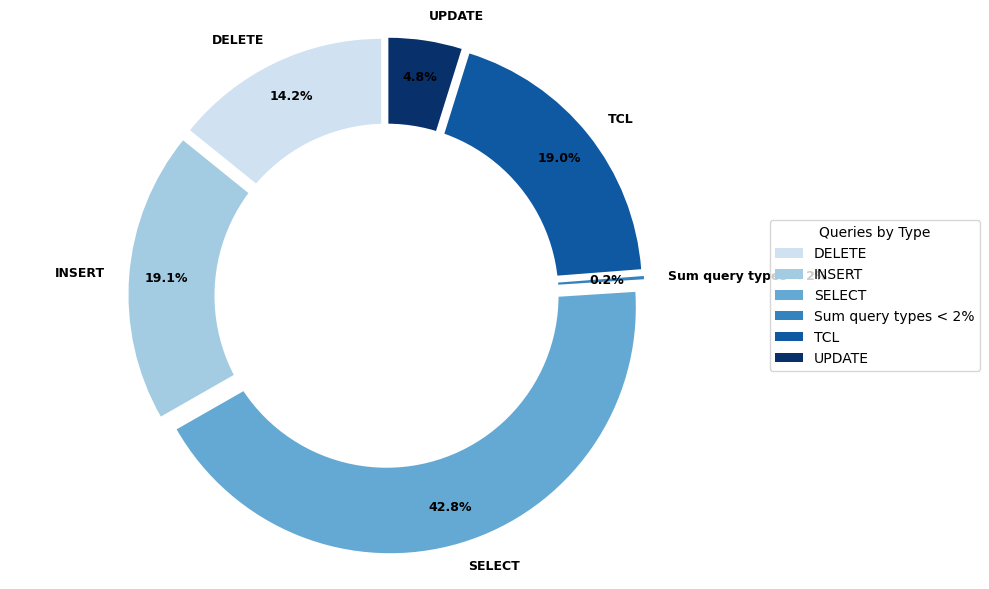

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from cycler import cycler

# Create a DataFrame
df_queries_by_type = pd.DataFrame(my_list_of_lists, columns=['Type', 'Count'])

# Calculate percentage
df_queries_by_type['Percentage'] = df_queries_by_type['Count'] / df_queries_by_type['Count'].sum() * 100

# Plotting the pie chart
labels = df_queries_by_type['Type'].to_list()
sizes = df_queries_by_type['Percentage'].to_list()
explode = tuple([0.05] * len(sizes))
num = len(sizes)

# Set up colors with a blue colormap
cmap = get_cmap('Blues')
inner_colors = cmap(np.linspace(0.2, 1, num))

# Plot the pie chart
fig, ax = plt.subplots(figsize=(10, 6))
wedges, texts, autotexts = ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, pctdistance=0.85, explode=explode,
                                  colors=inner_colors, textprops={'fontsize': 9, 'weight': 'bold'})

# Add a circle at the center to make it a donut chart
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that the pie is drawn as a circle
ax.axis('equal')

# Add legend
ax.legend(wedges, labels, title="Queries by Type", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# # Add title
# plt.title('Queries by Type', loc='left', fontsize=20, weight='bold', color="#9B9B9B")

# Save the figure
plt.tight_layout()

# Save the plot
fig.savefig('queries_by_type_image.png')

plt.show()

## Disk Space

In [24]:
file_disk_space= os.getenv('REPORT_SERVICE')+"database/size"
print(file_disk_space)

http://10.10.10.50:8000/report-service/api/v1/database/size


In [25]:
import json

# Open the file using urlopen
with urlopen(file_disk_space) as file:
    # Read the JSON content from the file
    json_data = json.load(file)

json_data

[{'db_name': 'postgres',
  'desc': 'ระบบน้ำสูญเสีย',
  'data': {'database_name': 'postgres',
   'total_database_size': 43397679,
   'total_table_size': 31506432,
   'total_index_size': 2826240}},
 {'db_name': 'core',
  'desc': 'ระบบคุณภาพน้ำ',
  'data': {'database_name': 'core',
   'total_database_size': 20226927,
   'total_table_size': 9805824,
   'total_index_size': 1409024}}]

## Disk Space

db_name: postgres
desc: ระบบน้ำสูญเสีย
database_name: postgres
total_database_size: 43,397,679
total_table_size: 31,506,432
total_index_size: 2,826,240
total database size in MB: 41.39


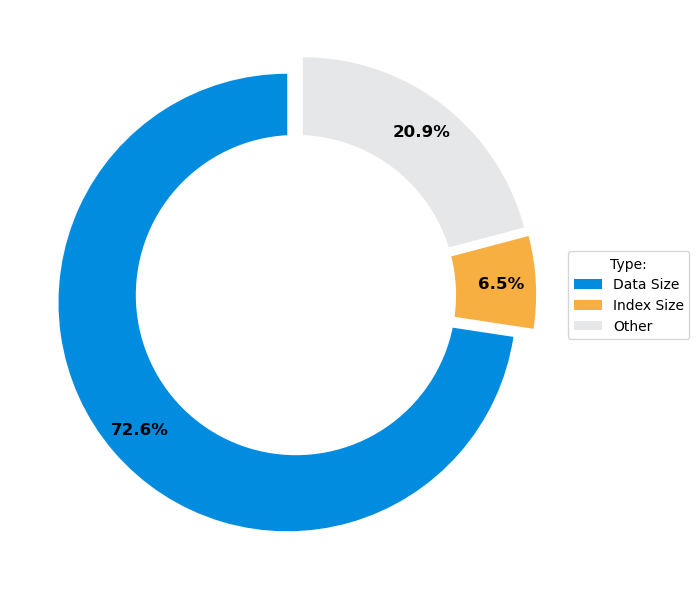

db_name: core
desc: ระบบคุณภาพน้ำ
database_name: core
total_database_size: 20,226,927
total_table_size: 9,805,824
total_index_size: 1,409,024
total database size in MB: 19.29


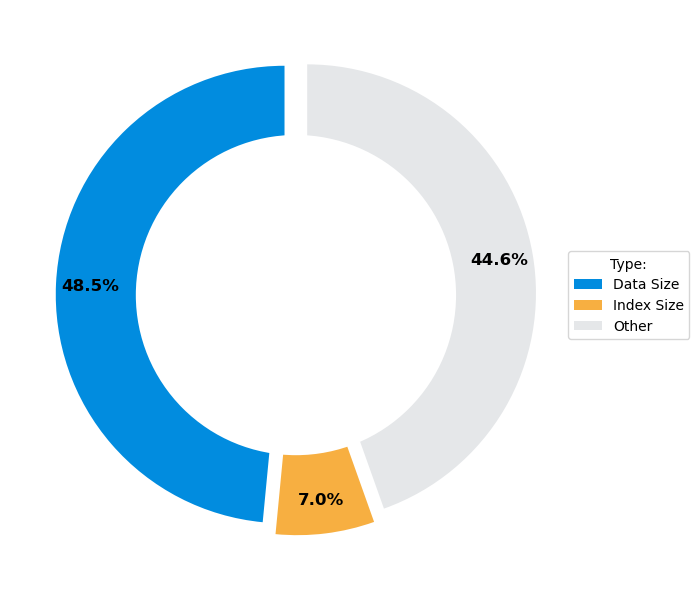

[{'total_database_size_mb': 41.39, 'image_disk_space': 'postgres_disk_space.png'}, {'total_database_size_mb': 19.29, 'image_disk_space': 'core_disk_space.png'}]


In [26]:
import matplotlib.pyplot as plt
import locale

# Set the locale for formatting numbers with commas
locale.setlocale(locale.LC_ALL, 'en_US.UTF-8')

disk_space = []  # List to store disk space information

for df_disk_space in json_data:
    # Access individual values and assign them to variables
    db_name_space = df_disk_space['db_name']
    desc_space = df_disk_space['desc']
    data_space = df_disk_space['data']

    # Access values within the 'data' dictionary
    database_name_space = data_space['database_name']
    total_database_size_space = data_space['total_database_size']
    total_table_size_space = data_space['total_table_size']
    total_index_size_space = data_space['total_index_size']

    # Print or use the variables as needed
    print("db_name:", db_name_space)
    print("desc:", desc_space)
    print("database_name:", database_name_space)
    print("total_database_size:", locale.format_string("%d", total_database_size_space, grouping=True))
    print("total_table_size:", locale.format_string("%d", total_table_size_space, grouping=True))
    print("total_index_size:", locale.format_string("%d", total_index_size_space, grouping=True))

    # Convert to Megabyte with 2 decimal places
    total_database_size_space_mb = round(total_database_size_space / (1024 * 1024), 2)

    print("total database size in MB:", locale.format_string("%.2f", total_database_size_space_mb, grouping=True))

    # Assuming you have calculated these percentages
    percent_table_size_space = (total_table_size_space / total_database_size_space) * 100
    percent_index_size_space = (total_index_size_space / total_database_size_space) * 100
    percent_other_space = 100 - percent_table_size_space - percent_index_size_space

    # Pie chart
    labels = ['Data Size', 'Index Size', 'Other']
    sizes = [percent_table_size_space, percent_index_size_space, percent_other_space]
    explode = tuple([0.05] * len(sizes))
    inner_colors = ['#018CDF', '#F7AF41', '#E5E7E9']

    plt.pie(sizes, colors=inner_colors, autopct='%1.1f%%', startangle=90, pctdistance=0.85, explode=explode,
            textprops={'fontsize': 12, 'weight': 'bold'})
    centre_circle = plt.Circle((0, 0), 0.70, fc='white')
    fig = plt.gcf()
    fig.gca().add_artist(centre_circle)

    plt.tight_layout()
    plt.legend(labels=labels, title="Type:", loc='right', bbox_to_anchor=(1.2, 0.5))
    # plt.title('Disk Space', loc='left', fontsize=20, weight='bold', color="#9B9B9B")
    fig.set_size_inches(6, 7)

    plt.show()

    # Save the plot
    image_disk_space = f'{db_name_space}_disk_space.png'
    fig.savefig(image_disk_space, bbox_inches='tight')
    plt.close()  # Close the plot to avoid overlapping when iterating over multiple datasets


    # Append the values to disk_space list
    disk_space.append({
        'total_database_size_mb': total_database_size_space_mb, 
        'image_disk_space': image_disk_space
    })

# Now, disk_space contains information for each iteration
print(disk_space)

In [27]:
pip install Pillow

Note: you may need to restart the kernel to use updated packages.


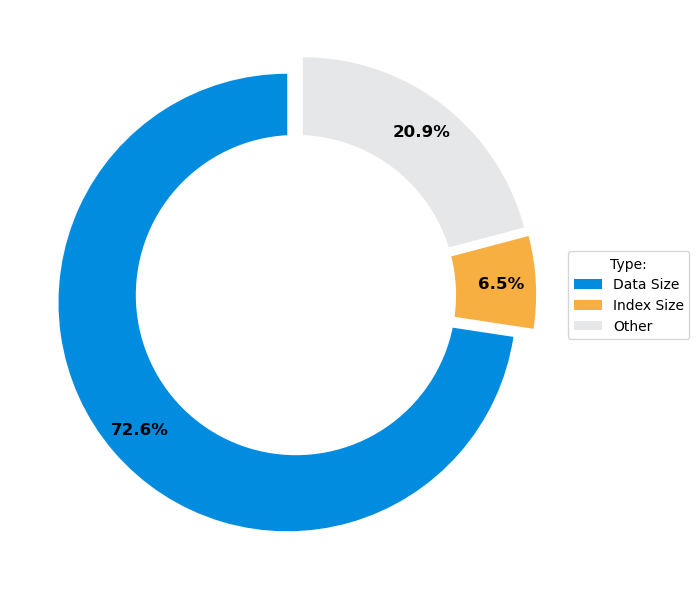

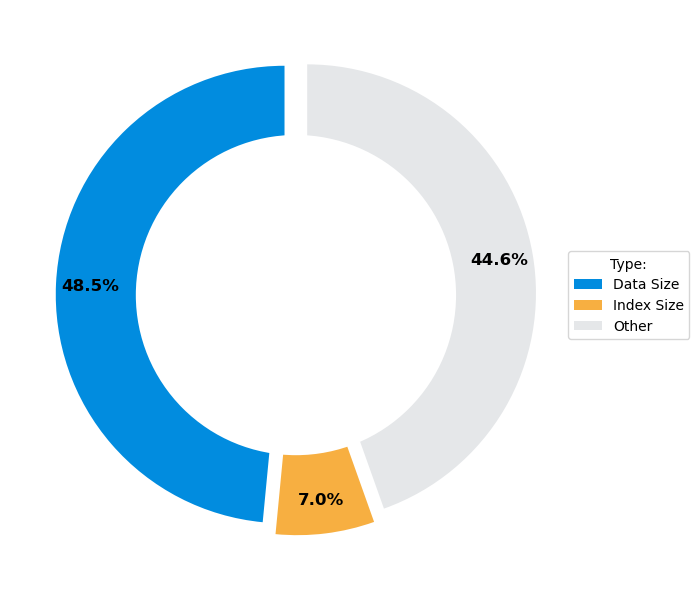

In [28]:
from PIL import Image
from IPython.display import display

# Iterate through the disk_space list and display images
for entry in disk_space:
    image_disk_space = entry['image_disk_space']
    img = Image.open(image_disk_space)
    display(img)


In [32]:
num_unique_queries, num_queries, queries_per_second, disk_space

(66,
 '2,451,152',
 368,
 [{'total_database_size_mb': 41.39,
   'image_disk_space': 'postgres_disk_space.png'},
  {'total_database_size_mb': 19.29,
   'image_disk_space': 'core_disk_space.png'}])

In [30]:
# .ipynb -> .py

!jupyter nbconvert --to script database_report.ipynb

[NbConvertApp] Converting notebook database_report.ipynb to script
[NbConvertApp] Writing 11132 bytes to database_report.py
